<a href="https://colab.research.google.com/github/kongpeiyen/crime-rates/blob/main/QM2_Groupwork.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Datasets Cleaning

In [ ]:
import pandas as pd
df1 = pd.read_csv(r'/content/data/MPS Borough Level Crime (24 months).csv',index_col=0)
df1.drop (['LookUp_BoroughName'], axis=1, inplace=True)
df1.drop(
    labels=["Arson and Criminal Damage","Miscellaneous Crimes Against Society", "Possession of Weapons", "Public Order Offences", "Robbery", "Theft", "Vehicle Offences", "Violence Against the Person"],
    axis=0,
    inplace=True
)
df1=df1.reset_index(drop=True) 
df1.columns.values[0]="MONTH"
#df1 = df1.set_index('MinorText', drop=True).rename_axis(None)
pd.options.display.max_rows = 198
df1.head(198)
df1= df1.groupby(by='MONTH').sum()
df1.T.head()

MONTH,Burglary - Business and Community,Burglary - Residential,Drug Trafficking,Other Sexual Offences,Possession of Drugs,Rape
201812,1654,5506,192,921,3080,562
201901,1839,5618,247,979,3254,679
201902,1703,4980,244,906,3223,668
201903,1823,5399,223,1061,4199,645
201904,1737,4582,273,944,3433,648


In [ ]:
df2 = pd.read_csv(r'/content/data/MPS_Borough_Level_Crime_Historic.csv',index_col=1) 
df2.drop (['Borough'], axis=1, inplace=True) 
df2.drop(
    labels=["Criminal Damage","Fraud or Forgery", "Other Notifiable Offences", "Robbery", "Theft and Handling", "Violence Against the Person"], 
    axis=0, 
    inplace=True 
)
df2=df2.reset_index(drop=True) 
df2.columns.values[0]="MONTH"
df2.rename(index = {"Burglary in Other Buildings": "Burglary - Business and Community", 
                     "Burglary in a Dwelling":"Burglary - Residential", "Other Sexual":"Other Sexual Offences"}, 
                                 inplace = True) 
df2= df2.groupby(by='MONTH').sum()
df2.rename(index = {"Burglary in Other Buildings": "Burglary - Business and Community", 
                     "Burglary in a Dwelling":"Burglary - Residential", "Other Sexual":"Other Sexual Offences", "Possession Of Drugs":"Possession of Drugs"}, 
                                 inplace = True) 
df2.drop(
    labels=["Other Drugs"], 
    axis=0, 
    inplace=True
)

df2.T.head()

MONTH,Burglary - Business and Community,Burglary - Residential,Drug Trafficking,Other Sexual Offences,Possession of Drugs,Rape
200801,2972,5867,341,594,5568,151
200802,2618,5043,363,544,6454,167
200803,2826,5065,396,597,6112,191
200804,2859,4359,447,535,5330,189
200805,2819,4466,446,579,6183,207


In [ ]:
df3 = pd.concat([df2, df1], axis=1, join='inner')
df3.head()
df3_final = df3.T
df3_final.head()

MONTH,Burglary - Business and Community,Burglary - Residential,Drug Trafficking,Other Sexual Offences,Possession of Drugs,Rape
200801,2972,5867,341,594,5568,151
200802,2618,5043,363,544,6454,167
200803,2826,5065,396,597,6112,191
200804,2859,4359,447,535,5330,189
200805,2819,4466,446,579,6183,207


In [ ]:
import pandas as pd
df3_final.rename(columns={"Burglary - Business and Community":"Burglary - Commercial"}, inplace=True)
df3_final.head()

MONTH,Burglary - Commercial,Burglary - Residential,Drug Trafficking,Other Sexual Offences,Possession of Drugs,Rape
200801,2972,5867,341,594,5568,151
200802,2618,5043,363,544,6454,167
200803,2826,5065,396,597,6112,191
200804,2859,4359,447,535,5330,189
200805,2819,4466,446,579,6183,207


In [ ]:
#selecting crimes
rape = df3_final[["Rape"]]


rape.head()

MONTH,Rape
200801,151
200802,167
200803,191
200804,189
200805,207


In [ ]:
commercialburglary = df3_final[["Burglary - Commercial"]]
commercialburglary.head()

MONTH,Burglary - Commercial
200801,2972
200802,2618
200803,2826
200804,2859
200805,2819


In [ ]:
#rape['Total'] =rape.loc[:,['201901','201902','201903','201904','201905','201906','201907','201908','201909','201910','201911','201912']].sum(axis=0)
rape.sum(axis = 0) 

MONTH
Rape    66297
dtype: int64

In [ ]:
possessionofdrugs = df3_final [["Possession of Drugs"]]
possessionofdrugs.head()


MONTH,Possession of Drugs
200801,5568
200802,6454
200803,6112
200804,5330
200805,6183


In [ ]:
othersexualoffences = df3_final[["Other Sexual Offences"]]
othersexualoffences.head()

MONTH,Other Sexual Offences
200801,594
200802,544
200803,597
200804,535
200805,579


In [ ]:
drugtrafficking = df3_final[["Drug Trafficking"]]
drugtrafficking.head()

MONTH,Drug Trafficking
200801,341
200802,363
200803,396
200804,447
200805,446


In [ ]:
residentialburglary = df3_final[["Burglary - Residential"]]
residentialburglary.head()

MONTH,Burglary - Residential
200801,5867
200802,5043
200803,5065
200804,4359
200805,4466


# Grouped Bar Charts


In [ ]:
# Summing the values of every months of 2015,2016,2017.2018 and 2019 to get a number for each borough for the whole year

c = df3.groupby(['MONTH']).sum().reset_index()
c['Total2015'] = c.loc[:,['201501', '201502', '201503', '201504', '201505', '201506', '201507', '201508', '201509', '201510', '201511','201512']].sum(axis=1)
c['Total2016'] = c.loc[:,['201601', '201602', '201603', '201604', '201605', '201606', '201607', '201608', '201609', '201610', '201611','201612']].sum(axis=1)
c['Total2017'] = c.loc[:,['201701', '201702', '201703', '201704', '201705', '201706', '201707', '201708', '201709', '201710', '201711','201712']].sum(axis=1)
c['Total2018'] = c.loc[:,['201801', '201802', '201803', '201804', '201805', '201806', '201807', '201808', '201809', '201810', '201811','201812']].sum(axis=1)
c['Total2019'] = c.loc[:,['201901', '201902', '201903', '201904', '201905', '201906', '201907', '201908', '201909', '201910', '201911','201912']].sum(axis=1)
c.drop (['200801', '200802', '200803', '200804', '200805', '200806', '200807', '200808', '200809', '200810', '200811','200812','200901', '200902', '200903', '200904', '200905', '200906', '200907', '200908', '200909', '200910', '200911','200912','201001', '201002', '201003', '201004', '201005', '201006', '201007', '201008', '201009', '201010', '201011','201012','201101', '201102', '201103', '201104', '201105', '201106', '201107', '201108', '201109', '201110', '201111','201112','201201', '201202', '201203', '201204', '201205', '201206', '201207', '201208', '201209', '201210', '201211','201212','201301', '201302', '201303', '201304', '201305', '201306', '201307', '201308', '201309', '201310', '201311','201312','201401', '201402', '201403', '201404', '201405', '201406', '201407', '201408', '201409', '201410', '201411','201412'], axis=1, inplace=True)
c.head()

,MONTH,201501,201502,201503,201504,201505,201506,201507,201508,201509,201510,201511,201512,201601,201602,201603,201604,201605,201606,201607,201608,201609,201610,201611,201612,201701,201702,201703,201704,201705,201706,201707,201708,201709,201710,201711,201712,201801,201802,201803,201804,201805,201806,201807,201808,201809,201810,201811,201812,201812,201901,201902,201903,201904,201905,201906,201907,201908,201909,201910,201911,201912,202001,202002,202003,202004,202005,202006,202007,202008,202009,202010,202011,Total2015,Total2016,Total2017,Total2018,Total2019
0,Burglary - Business and Community,1977,1985,2380,2327,2353,2085,2196,2089,2138,2125,2164,2071,2023,1980,2241,2195,2212,2129,2158,2127,1969,2127,2086,2133,3422,3312,3613,2741,2980,2610,2881,2950,2647,2711,2747,2632,3092,2736,2973,3000,2895,2962,3020,3133,2963,3202,2955,2974,1654,1839,1703,1823,1737,1816,1877,1803,1747,1668,1826,1666,1550,1751,1595,1540,1144,947,991,1152,1052,1190,1278,1050,25890,25380,35246,37559,21055
1,Burglary - Residential,4550,3994,3966,3113,3216,3212,3207,3286,3290,3826,4625,4397,4288,3862,3572,3147,3197,3261,3246,3287,3325,3363,3989,4486,4274,3843,4011,4334,4145,4168,4447,4443,4438,5167,5791,5451,5923,5065,4665,4626,4654,4322,4416,4662,4383,5281,6232,5505,5506,5618,4980,5399,4582,4596,4494,4510,4417,4858,5468,5431,5286,5241,4706,3819,2520,2945,3322,3807,3953,4012,4385,4161,44682,43023,54512,65240,59639
2,Drug Trafficking,316,266,302,339,248,272,342,337,283,298,275,245,419,328,254,275,325,319,354,299,278,242,223,204,275,288,477,212,316,279,363,286,285,324,237,170,200,247,229,200,178,200,191,181,196,232,233,140,192,247,244,223,273,286,255,304,329,214,328,270,211,288,296,275,342,458,367,508,326,411,323,336,3523,3520,3512,2619,3184
3,Other Sexual Offences,783,759,908,763,883,916,963,825,807,897,987,885,874,875,960,865,1013,951,1094,865,935,982,896,837,886,884,1109,871,1040,1086,1086,1008,1027,1066,1141,895,989,883,1078,952,1052,1135,1177,953,1031,1053,1033,919,921,979,906,1061,944,1052,1153,1176,907,1014,933,1072,900,984,1129,987,542,770,900,1063,1055,1033,1087,1010,10376,11147,12099,13176,12097
4,Possession of Drugs,3412,3079,2982,2823,2878,3051,3221,3180,3134,3376,3008,2817,3445,3088,3104,3176,3018,2775,3111,3207,2907,3018,2698,2472,2813,2421,2904,2648,2854,2561,2879,3089,2797,3098,2930,2419,2856,2554,2556,2766,2846,2457,2398,3097,2732,2813,2959,2940,3080,3254,3223,4199,3433,3624,3832,4254,4502,3767,3651,3747,3265,4394,3891,3674,4980,6298,4559,4328,3421,3293,3904,4086,36961,36019,33413,36054,44751


In [ ]:
c.drop (['201501', '201502', '201503', '201504', '201505', '201506', '201507', '201508', '201509', '201510', '201511','201512','201601', '201602', '201603', '201604', '201605', '201606', '201607', '201608', '201609', '201610', '201611','201612','201701', '201702', '201703', '201704', '201705', '201706', '201707', '201708', '201709', '201710', '201711','201712','201801', '201802', '201803', '201804', '201805', '201806', '201807', '201808', '201809', '201810', '201811','201812','201901', '201902', '201903', '201904', '201905', '201906', '201907', '201908', '201909', '201910', '201911','201912','202001', '202002', '202003', '202004', '202005', '202006', '202007', '202008', '202009', '202010', '202011'], axis=1, inplace=True)
c.head(6)

,MONTH,Total2015,Total2016,Total2017,Total2018,Total2019
0,Burglary - Business and Community,25890,25380,35246,37559,21055
1,Burglary - Residential,44682,43023,54512,65240,59639
2,Drug Trafficking,3523,3520,3512,2619,3184
3,Other Sexual Offences,10376,11147,12099,13176,12097
4,Possession of Drugs,36961,36019,33413,36054,44751
5,Rape,5454,6300,7659,8828,7926


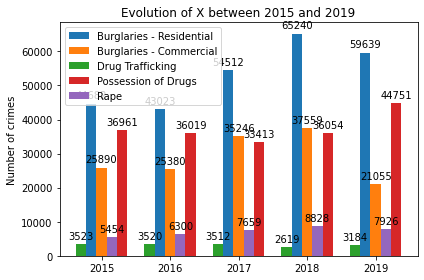

In [ ]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np


labels = ['2015', '2016', '2017', '2018', '2019']
burgr = [44682, 43023, 54512, 65240, 59639]
burgc = [25890, 25380, 35246, 37559, 21055]
drugt = [3523, 3520, 3512, 2619, 3184]
otherso = [10376, 11147, 12099, 13176, 12097]
possod = [36961, 36019, 33413, 36054, 44751]
rape = [5454, 6300, 7659, 8828, 7926]


x = np.arange(len(labels))  # the label locations
width = 0.15  # the width of the bars


fig, ax = plt.subplots()
rects1 = ax.bar(x - width, burgr, width, label='Burglaries - Residential')
rects2 = ax.bar(x, burgc, width, label='Burglaries - Commercial')
rects3 = ax.bar(x - width*2, drugt, width, label='Drug Trafficking')
rects4 = ax.bar(x + width*2, possod, width, label='Possession of Drugs')
rects5 = ax.bar(x + width, rape, width, label='Rape')
#rects6 = ax.bar(x + width/2, otherso, width, label='Other Sexual Offences')

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Number of crimes')
ax.set_title('Evolution of X between 2015 and 2019')
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.legend()


def autolabel(rects):
    """Attach a text label above each bar in *rects*, displaying its height."""
    for rect in rects:
        height = rect.get_height()
        ax.annotate('{}'.format(height),
                    xy=(rect.get_x() + rect.get_width() / 2, height),
                    xytext=(0, 3),  # 3 points vertical offset
                    textcoords="offset points",
                    ha='center', va='bottom')


autolabel(rects1)
autolabel(rects2)
autolabel(rects3)
autolabel(rects4)
autolabel(rects5)
#autolabel(rects6)


fig.tight_layout()

plt.show()

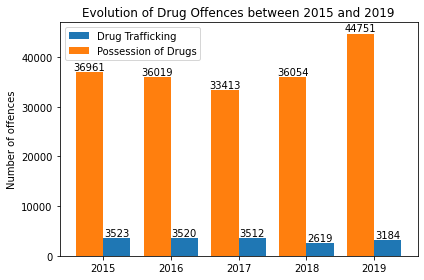

In [ ]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
labels = ['2015', '2016', '2017', '2018', '2019']
drugt = [3523, 3520, 3512, 2619, 3184]
possod = [36961, 36019, 33413, 36054, 44751]

x = np.arange(len(labels))  # the label locations
width = 0.40  # the width of the bars


fig, ax = plt.subplots()
rects1 = ax.bar(x + width/2, drugt, width, label='Drug Trafficking')
rects2 = ax.bar(x - width/2, possod, width, label='Possession of Drugs')


# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Number of offences')
ax.set_title('Evolution of Drug Offences between 2015 and 2019')
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.legend()


def autolabel(rects):
    """Attach a text label above each bar in *rects*, displaying its height."""
    for rect in rects:
        height = rect.get_height()
        ax.annotate('{}'.format(height),
                    xy=(rect.get_x() + rect.get_width() / 2, height),
                    xytext=(0, 0),  # 3 points vertical offset
                    textcoords="offset points",
                    ha='center', va='bottom')


autolabel(rects1)
autolabel(rects2)
fig.tight_layout()

plt.show()

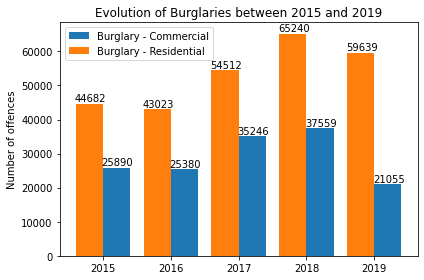

In [ ]:
labels = ['2015', '2016', '2017', '2018', '2019']
burgr = [44682, 43023, 54512, 65240, 59639]
burgc = [25890, 25380, 35246, 37559, 21055]

x = np.arange(len(labels))  # the label locations
width = 0.40  # the width of the bars


fig, ax = plt.subplots()
rects1 = ax.bar(x + width/2, burgc, width, label='Burglary - Commercial')
rects2 = ax.bar(x - width/2, burgr, width, label='Burglary - Residential')


# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Number of offences')
ax.set_title('Evolution of Burglaries between 2015 and 2019')
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.legend()


def autolabel(rects):
    """Attach a text label above each bar in *rects*, displaying its height."""
    for rect in rects:
        height = rect.get_height()
        ax.annotate('{}'.format(height),
                    xy=(rect.get_x() + rect.get_width() / 2, height),
                    xytext=(1, 0),  # 3 points vertical offset
                    textcoords="offset points",
                    ha='center', va='bottom')


autolabel(rects1)
autolabel(rects2)
fig.tight_layout()
plt.show()

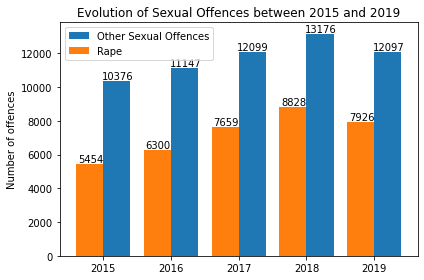

In [ ]:
labels = ['2015', '2016', '2017', '2018', '2019']
otherso = [10376, 11147, 12099, 13176, 12097]
rape = [5454, 6300, 7659, 8828, 7926]

x = np.arange(len(labels))  # the label locations
width = 0.40  # the width of the bars

fig, ax = plt.subplots()
rects3 = ax.bar(x + width/2, otherso, width, label='Other Sexual Offences')
rects4 = ax.bar(x - width/2, rape, width, label='Rape')


# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Number of offences')
ax.set_title('Evolution of Sexual Offences between 2015 and 2019')
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.legend()


def autolabel(rects):
    """Attach a text label above each bar in *rects*, displaying its height."""
    for rect in rects:
        height = rect.get_height()
        ax.annotate('{}'.format(height),
                    xy=(rect.get_x() + rect.get_width() / 2, height),
                    xytext=(1, -0.5),  # 3 points vertical offset
                    textcoords="offset points",
                    ha='center', va='bottom')
autolabel(rects3)
autolabel(rects4)
fig.tight_layout()

plt.show()

# Line Plots


In [ ]:
df3_final['Total'] =df3_final.loc[:,['201901','201902','201903','201904','201905','201906','201907','201908','201909','201910','201911','201912']].sum(axis=0)

KeyError: ignored

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

crimes = ["Buglary - Residential", "Burglary - Commercial", "Drug Trafficking", "Possession of Drugs", "Rape", "Other Sexual Offences"]
# Create a column that has the year of each date recording
df["year"] = df.index.year
# Create a column that has the month (1-12) of each date recording
df["month"] = df.index.month
# Map the month integers to their proper names
df["month"] = df["month"].apply(
    lambda data: months[data-1]
)
# Make this a categorical column so it can be sorted by the order of values\
# in the `months` list, i.e., the proper month order
df["month"] = pd.Categorical(df["month"], categories=months)

# Pivot the DF so that there's a column for each month, each row\
# represents a year, and the cells have the mean page views for the\
# respective year and month
df_pivot = pd.pivot_table(
	df,
	values="page_views",
	index="year",
	columns="month",
	aggfunc=np.mean
)

# Plot a bar chart using the DF
ax = df_pivot.plot(kind="bar")
# Get a Matplotlib figure from the axes object for formatting purposes
fig = ax.get_figure()
# Change the plot dimensions (width, height)
fig.set_size_inches(7, 6)
# Change the axes labels
ax.set_xlabel("Years")
ax.set_ylabel("Average Page Views")

# Use this to show the plot in a new window
# plt.show()
# Export the plot as a PNG file
fig.savefig("page_views_barplot.png")

In [ ]:
residentialburglary.index = pd.to_datetime(residentialburglary.index, format='%Y%m')
commercialburglary.index = pd.to_datetime(commercialburglary.index, format='%Y%m')
rape.index = pd.to_datetime(rape.index, format='%Y%m')
drugtrafficking.index = pd.to_datetime(drugtrafficking.index, format='%Y%m')
othersexualoffences.index = pd.to_datetime(othersexualoffences.index, format='%Y%m')
possessionofdrugs.index = pd.to_datetime(possessionofdrugs.index, format='%Y%m')

In [ ]:
figrape = px.line(rape, x = rape.index, y = 'Rape', title='Number of Rapes in London over time')
figrape.show()

NameError: ignored

In [ ]:
figcb = px.line(commercialburglary, x = commercialburglary.index, y = 'Burglary - Commercial', title='Number of Commercial Burglaries in London over time')
figcb.show()

NameError: ignored

In [ ]:
figrb = px.line(residentialburglary, x = residentialburglary.index, y = 'Burglary - Residential', title='Number of Residential Burglaries in London over time')
figrb.show()

In [ ]:
figdt = px.line(drugtrafficking, x = drugtrafficking.index, y = 'Drug Trafficking', title='Drug Trafficking offences in London over time')
figdt.show()

In [ ]:
figoso = px.line(othersexualoffences, x = othersexualoffences.index, y = 'Other Sexual Offences', title='Other sexual offences in London over time')
figoso.show()

In [ ]:
figpod = px.line(possessionofdrugs, x = possessionofdrugs.index, y = 'Possession of Drugs', title='Possesion of Drugs offences in London over time')
figpod.show()

In [ ]:
pod = possessionofdrugs
pod.reset_index(inplace=True)
pod.columns.values[0]="Month"
pod.columns.values[1]="Possession of Drugs"

oso = othersexualoffences
oso.reset_index(inplace=True)
oso.columns.values[0]="Month"
oso.columns.values[1]="Other Sexual Offences"

dt = drugtrafficking
dt.reset_index(inplace=True)
dt.columns.values[0]="Month"
dt.columns.values[1]="Drug Trafficking"

rb = residentialburglary
rb.reset_index(inplace=True)
rb.columns.values[0]="Month"
rb.columns.values[1]="Burglary - Residential"

cb = commercialburglary
cb.reset_index(inplace=True)
cb.columns.values[0]="Month"
cb.columns.values[1]="Burglary - Commercial"

r = rape
r.reset_index(inplace=True)
r.columns.values[0]="Month"
r.columns.values[1]="Rape"


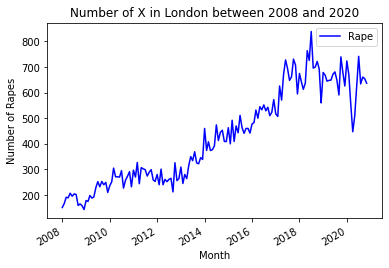

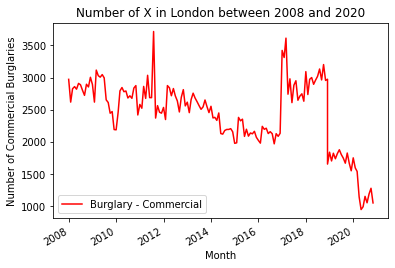

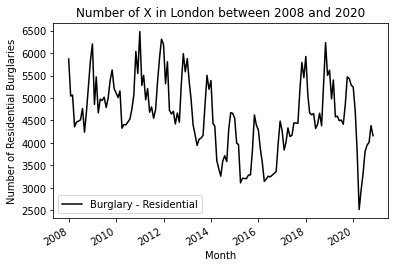

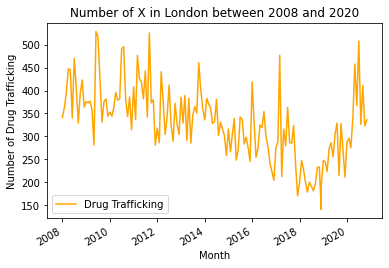

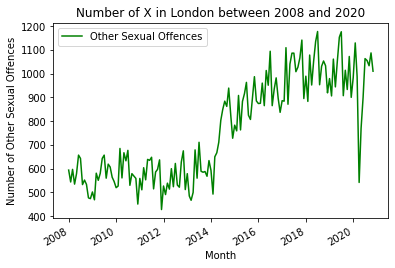

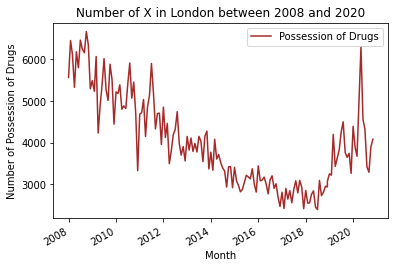

<Figure size 432x288 with 0 Axes>

In [ ]:
import matplotlib.pyplot as plt
r.plot(kind='line',x='Month',y='Rape',color='blue')
plt.ylabel('Number of Rapes')
plt.title('Number of X in London between 2008 and 2020')
cb.plot(kind='line',x='Month',y='Burglary - Commercial',color='red')
plt.ylabel('Number of Commercial Burglaries')
plt.title('Number of X in London between 2008 and 2020')
rb.plot(kind='line',x='Month',y='Burglary - Residential',color='black')
plt.ylabel('Number of Residential Burglaries')
plt.title('Number of X in London between 2008 and 2020')
dt.plot(kind='line',x='Month',y='Drug Trafficking',color='orange')
plt.ylabel('Number of Drug Trafficking')
plt.title('Number of X in London between 2008 and 2020')
oso.plot(kind='line',x='Month',y='Other Sexual Offences',color='green')
plt.ylabel('Number of Other Sexual Offences')
plt.title('Number of X in London between 2008 and 2020')
pod.plot(kind='line',x='Month',y='Possession of Drugs',color='brown')
plt.ylabel('Number of Possession of Drugs')
plt.title('Number of X in London between 2008 and 2020')
plt.show()
#HOW TO SAVE INTO .png
plt.savefig('output.png')


#Predicted model: Commercial Burglaries

In [ ]:
# Importing necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
get_ipython().run_line_magic('matplotlib', 'inline')
import warnings
warnings.filterwarnings('ignore')


In [ ]:
#Installing pmdarima package
get_ipython().system(' pip install pmdarima')
# Importing auto_arima 
from pmdarima.arima import auto_arima

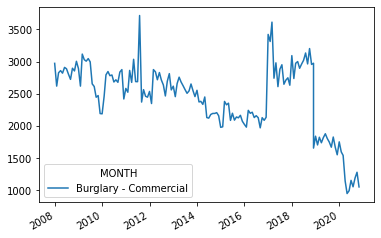

In [ ]:
#Read the crime dataset and plot it
import pandas as pd
commercialburglary.index = pd.to_datetime(commercialburglary.index, format='%Y%m')
commercialburglary.plot()

In [ ]:
#Spliting the dataset into train and test 
train = commercialburglary['2008-01-01': '2020-01-01']
test = commercialburglary['2020-01-01':] 

In [ ]:
#Building ARIMA model 
arima_model =  auto_arima(train,start_p=0, d=1, start_q=0, 
                          max_p=5, max_d=5, max_q=5, start_P=0, 
                          D=1, start_Q=0, max_P=5, max_D=5,
                          max_Q=5, m=12, seasonal=True, 
                          error_action='warn',trace = True,
                          supress_warnings=True,stepwise = True,
                          random_state=20,n_fits = 50 )
arima_model.summary()

Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=1958.209, Time=0.03 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=1930.232, Time=0.22 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=0.64 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=1945.495, Time=0.04 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=1894.856, Time=0.65 sec
 ARIMA(1,1,0)(3,1,0)[12]             : AIC=1888.532, Time=1.50 sec
 ARIMA(1,1,0)(4,1,0)[12]             : AIC=1879.523, Time=3.00 sec
 ARIMA(1,1,0)(5,1,0)[12]             : AIC=1873.754, Time=4.85 sec
 ARIMA(1,1,0)(5,1,1)[12]             : AIC=inf, Time=nan sec
 ARIMA(1,1,0)(4,1,1)[12]             : AIC=inf, Time=7.88 sec
 ARIMA(0,1,0)(5,1,0)[12]             : AIC=1886.084, Time=4.28 sec
 ARIMA(2,1,0)(5,1,0)[12]             : AIC=1875.633, Time=6.61 sec
 ARIMA(1,1,1)(5,1,0)[12]             : AIC=1875.488, Time=7.62 sec
 ARIMA(0,1,1)(5,1,0)[12]             : AIC=1874.783, Time=5.70 sec
 ARIMA(2,1,1)(5,1,0)[12]           

<class 'statsmodels.iolib.summary.Summary'>
"""
                                     SARIMAX Results                                      
==========================================================================================
Dep. Variable:                                  y   No. Observations:                  146
Model:             SARIMAX(1, 1, 0)x(5, 1, 0, 12)   Log Likelihood                -929.877
Date:                            Thu, 24 Dec 2020   AIC                           1873.754
Time:                                    10:51:03   BIC                           1893.987
Sample:                                         0   HQIC                          1881.976
                                            - 146                                         
Covariance Type:                              opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.3204      0.060     -5.326      0.000      -0.438      -0.203
ar.S.L12      -0.8442      0.111     -7.605      0.000      -1.062      -0.627
ar.S.L24      -1.0696      0.108     -9.888      0.000      -1.282      -0.858
ar.S.L36      -0.8096      0.151     -5.349      0.000      -1.106      -0.513
ar.S.L48      -0.5753      0.173     -3.324      0.001      -0.915      -0.236
ar.S.L60      -0.3111      0.167     -1.859      0.063      -0.639       0.017
sigma2      5.806e+04   5102.175     11.379      0.000    4.81e+04    6.81e+04
===================================================================================
Ljung-Box (L1) (Q):                   0.02   Jarque-Bera (JB):               415.61
Prob(Q):                              0.90   Prob(JB):                         0.00
Heteroskedasticity (H):               1.69   Skew:                             0.37
Prob(H) (two-sided):                  0.08   Kurtosis:                        11.63
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [ ]:
#Finding predicted crime values
prediction = pd.DataFrame(arima_model.predict(n_periods = 11),index=test.index)
prediction.columns = ['predicted_commercialburglary']
prediction.index.name = 'MONTH'

In [ ]:
#Finding prediction interval as an array
conf_int = arima_model.predict(11,return_conf_int=True,alpha=0.05)
interval = pd.DataFrame(conf_int[1], columns = ['min','max'])
#Create month column
import pandas as pd
dates = pd.DataFrame({'MONTH':['202001','202002','202003','202004','202005','202006','202007', '202008', '202009', '202010', '202011']})
#Put together min max and month
table = pd.concat([dates, interval], axis=1)
#Convert the month column to datetime and set the index of the Month 
table['MONTH'] = pd.to_datetime(table['MONTH'], format='%Y%m')
table = table.set_index('MONTH') 
table

,min,max
MONTH,,
2020-01-01,1391.487562,2335.980216
2020-02-01,1058.229799,2200.169181
2020-03-01,1062.110152,2422.214376
2020-04-01,688.688746,2221.916377
2020-05-01,708.440194,2401.332777
2020-06-01,599.472001,2436.973959
2020-07-01,463.931911,2435.835520
2020-08-01,385.138953,2482.738880
2020-09-01,419.920213,2636.132581


In [ ]:
min = table[["min"]]
max =  table[["max"]]

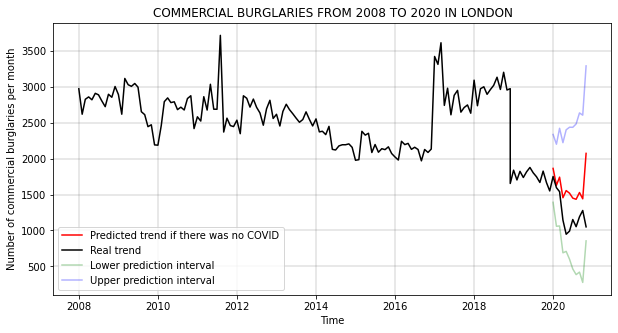

In [ ]:
#Plotting predicted values and real values from 2020
plt.figure(figsize=(10,5))
plt.plot(prediction,label="Predicted trend if there was no COVID", color='r')
plt.plot(commercialburglary,label="Real trend", color='black')
plt.plot(min, label="Lower prediction interval", color="g", alpha=0.3)
plt.plot(max, label="Upper prediction interval", color="b", alpha=0.3)
plt.legend(loc = 'Left corner')
plt.title("COMMERCIAL BURGLARIES FROM 2008 TO 2020 IN LONDON")
plt.xlabel("Time")
plt.ylabel("Number of commercial burglaries per month")
plt.grid(b=True, which='major', color='#666666', linestyle='-', linewidth=0.3)
plt.show()

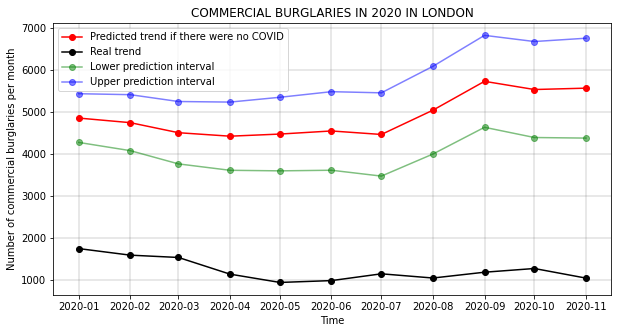

In [ ]:
import pandas as pd
commercialburglary.index = pd.to_datetime(commercialburglary.index, format='%Y%m')
commercialburglary_2020 = commercialburglary.tail(11)
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

#Plotting predicted values and real values from 2020
plt.figure(figsize=(10,5))
plt.plot(prediction.index,prediction, linestyle='-', marker='o', label="Predicted trend if there were no COVID",color='r')
plt.plot(commercialburglary_2020.index, commercialburglary_2020, label="Real trend", color='black', linestyle='-', marker='o')
plt.plot(min.index, min, label="Lower prediction interval", color="g", alpha=0.5, linestyle='-', marker='o')
plt.plot(max.index, max, label="Upper prediction interval", color="b", alpha=0.5, linestyle='-', marker='o')
plt.legend(loc = 'Left corner')
plt.title("COMMERCIAL BURGLARIES IN 2020 IN LONDON")
plt.xlabel("Time")
plt.ylabel("Number of commercial burglaries per month")
plt.grid(b=True, which='major', color='#666666', linestyle='-', linewidth=0.3)
plt.show()

#Predicted model: Residential Burglary

In [ ]:
# Importing necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
get_ipython().run_line_magic('matplotlib', 'inline')
import warnings
warnings.filterwarnings('ignore')


In [ ]:
#Installing pmdarima package
get_ipython().system(' pip install pmdarima')
# Importing auto_arima 
from pmdarima.arima import auto_arima

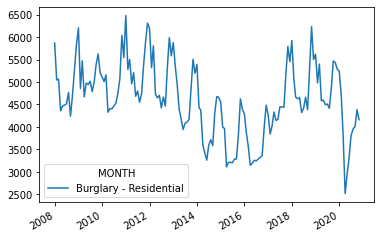

In [ ]:
#Read the crime dataset and plot it
import pandas as pd
residentialburglary.index = pd.to_datetime(residentialburglary.index, format='%Y%m')
residentialburglary.plot()

In [ ]:
#Spliting the dataset into train and test 
train = residentialburglary['2008-01-01': '2020-01-01']
test = residentialburglary['2020-01-01':] 

In [ ]:
#Building ARIMA model 
arima_model =  auto_arima(train,start_p=0, d=1, start_q=0, 
                          max_p=5, max_d=5, max_q=5, start_P=0, 
                          D=1, start_Q=0, max_P=5, max_D=5,
                          max_Q=5, m=12, seasonal=True, 
                          error_action='warn',trace = True,
                          supress_warnings=True,stepwise = True,
                          random_state=20,n_fits = 50 )
arima_model.summary()

Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=1986.811, Time=0.03 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=1928.797, Time=0.33 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=1907.865, Time=0.96 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=1958.705, Time=0.07 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=1909.153, Time=1.02 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=1909.023, Time=1.80 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=1924.657, Time=0.25 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=inf, Time=3.13 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=1931.757, Time=0.27 sec
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=1909.171, Time=0.66 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=1908.998, Time=0.60 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=1910.077, Time=0.67 sec
 ARIMA(1,1,2)(0,1,1)[12]             : AIC=inf, Time=1.69 sec
 ARIMA(0,1,1)(0,1,1)[12] intercept   : AIC=1909.856, Time=0.90 sec

Best model:  ARIMA(0,1,1)(0,

<class 'statsmodels.iolib.summary.Summary'>
"""
                                     SARIMAX Results                                      
==========================================================================================
Dep. Variable:                                  y   No. Observations:                  146
Model:             SARIMAX(0, 1, 1)x(0, 1, 1, 12)   Log Likelihood                -950.932
Date:                            Sun, 27 Dec 2020   AIC                           1907.865
Time:                                    18:16:32   BIC                           1916.536
Sample:                                         0   HQIC                          1911.388
                                            - 146                                         
Covariance Type:                              opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.4339      0.062     -6.991      0.000      -0.556      -0.312
ma.S.L12      -0.7281      0.085     -8.556      0.000      -0.895      -0.561
sigma2      8.701e+04   8845.964      9.836      0.000    6.97e+04    1.04e+05
===================================================================================
Ljung-Box (L1) (Q):                   0.18   Jarque-Bera (JB):                 9.31
Prob(Q):                              0.67   Prob(JB):                         0.01
Heteroskedasticity (H):               1.07   Skew:                             0.21
Prob(H) (two-sided):                  0.83   Kurtosis:                         4.23
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [ ]:
#Finding predicted crime values
prediction = pd.DataFrame(arima_model.predict(n_periods = 11),index=test.index)
prediction.columns = ['predicted_residentialburglary']
prediction.index.name = 'MONTH'

In [ ]:
#Finding prediction interval as an array
conf_int = arima_model.predict(11,return_conf_int=True,alpha=0.05)
interval = pd.DataFrame(conf_int[1], columns = ['min','max'])
#Create month column
import pandas as pd
dates = pd.DataFrame({'MONTH':['202001','202002','202003','202004','202005','202006','202007', '202008', '202009', '202010', '202011']})
#Put together min max and month
table = pd.concat([dates, interval], axis=1)
#Convert the month column to datetime and set the index of the Month 
table['MONTH'] = pd.to_datetime(table['MONTH'], format='%Y%m')
table = table.set_index('MONTH') 
min = table[["min"]]
max =  table[["max"]]

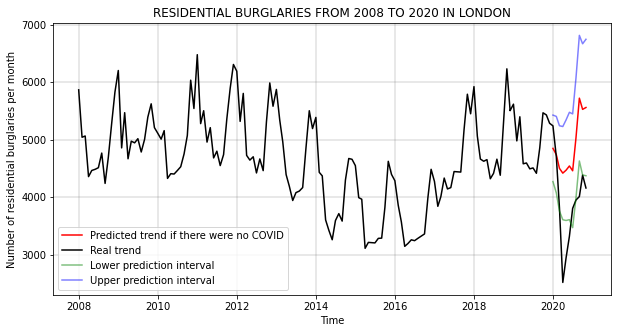

In [ ]:
#Plotting predicted values and real values from 2020
plt.figure(figsize=(10,5))
plt.plot(prediction,label="Predicted trend if there were no COVID", color='r')
plt.plot(residentialburglary,label="Real trend", color='black')
plt.plot(min, label="Lower prediction interval", color="g", alpha=0.5)
plt.plot(max, label="Upper prediction interval", color="b", alpha=0.5)
plt.legend(loc = 'Left corner')
plt.title("RESIDENTIAL BURGLARIES FROM 2008 TO 2020 IN LONDON")
plt.xlabel("Time")
plt.ylabel("Number of residential burglaries per month")
plt.grid(b=True, which='major', color='#666666', linestyle='-', linewidth=0.3)
plt.show()

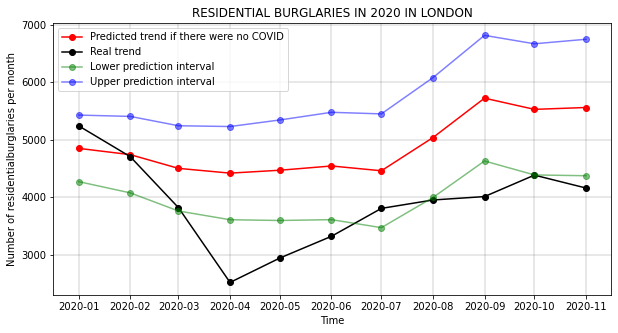

In [ ]:
import pandas as pd
residentialburglary.index = pd.to_datetime(residentialburglary.index, format='%Y%m')
residentialburglary_2020 = residentialburglary.tail(11)
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

#Plotting predicted values and real values from 2020
plt.figure(figsize=(10,5))
plt.plot(prediction.index,prediction, linestyle='-', marker='o', label="Predicted trend if there were no COVID",color='r')
plt.plot(residentialburglary_2020.index, residentialburglary_2020, label="Real trend", color='black', linestyle='-', marker='o')
plt.plot(min.index, min, label="Lower prediction interval", color="g", alpha=0.5, linestyle='-', marker='o')
plt.plot(max.index, max, label="Upper prediction interval", color="b", alpha=0.5, linestyle='-', marker='o')
plt.legend(loc = 'Left corner')
plt.title("RESIDENTIAL BURGLARIES IN 2020 IN LONDON")
plt.xlabel("Time")
plt.ylabel("Number of residentialburglaries per month")
plt.grid(b=True, which='major', color='#666666', linestyle='-', linewidth=0.3)
plt.show()

#Predictive model: Possession of Drugs

In [ ]:
# Importing necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
get_ipython().run_line_magic('matplotlib', 'inline')
import warnings
warnings.filterwarnings('ignore')

In [ ]:
#Installing pmdarima package
get_ipython().system(' pip install pmdarima')
# Importing auto_arima 
from pmdarima.arima import auto_arima

MONTH,Possession of Drugs
2019-12-01,3265
2020-01-01,4394
2020-02-01,3891
2020-03-01,3674
2020-04-01,4980
2020-05-01,6298
2020-06-01,4559
2020-07-01,4328
2020-08-01,3421
2020-09-01,3293


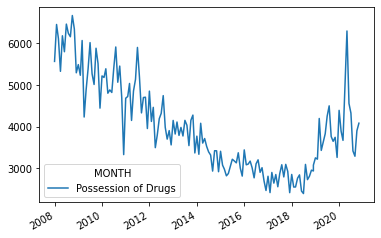

In [ ]:
#Read the crime dataset and plot it
import pandas as pd
possessionofdrugs.index = pd.to_datetime(possessionofdrugs.index, format='%Y%m')
possessionofdrugs.plot()
possessionofdrugs.tail(12)

In [ ]:
#Spliting the dataset into train and test 
train = possessionofdrugs['2008-01-01': '2020-01-01']
test = possessionofdrugs['2020-01-01':] 

In [ ]:
#Building ARIMA model 
arima_model =  auto_arima(train,start_p=0, d=1, start_q=0, 
                          max_p=5, max_d=5, max_q=5, start_P=0, 
                          D=1, start_Q=0, max_P=5, max_D=5,
                          max_Q=5, m=12, seasonal=True, 
                          error_action='warn',trace = True,
                          supress_warnings=True,stepwise = True,
                          random_state=20,n_fits = 50 )
arima_model.summary()

Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=2014.206, Time=0.02 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=1980.159, Time=0.21 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=1963.885, Time=0.49 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=1994.892, Time=0.09 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=1964.631, Time=0.62 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=1964.035, Time=1.25 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=1968.934, Time=0.27 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=1965.125, Time=2.21 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=1987.037, Time=0.28 sec
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=1963.229, Time=0.75 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=1991.645, Time=0.22 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=1963.743, Time=0.90 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=1962.825, Time=1.69 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=1963.234, Time=2.82 sec
 ARIMA(1,1,1)(0,1,3

<class 'statsmodels.iolib.summary.Summary'>
"""
                                     SARIMAX Results                                      
==========================================================================================
Dep. Variable:                                  y   No. Observations:                  146
Model:             SARIMAX(0, 1, 2)x(0, 1, 2, 12)   Log Likelihood                -976.174
Date:                            Sun, 27 Dec 2020   AIC                           1962.349
Time:                                    18:13:33   BIC                           1976.801
Sample:                                         0   HQIC                          1968.222
                                            - 146                                         
Covariance Type:                              opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.4670      0.084     -5.563      0.000      -0.632      -0.302
ma.L2         -0.1813      0.074     -2.458      0.014      -0.326      -0.037
ma.S.L12      -0.6322      0.099     -6.357      0.000      -0.827      -0.437
ma.S.L24       0.1799      0.124      1.452      0.147      -0.063       0.423
sigma2      1.328e+05   1.69e+04      7.872      0.000    9.98e+04    1.66e+05
===================================================================================
Ljung-Box (L1) (Q):                   0.24   Jarque-Bera (JB):                 1.23
Prob(Q):                              0.62   Prob(JB):                         0.54
Heteroskedasticity (H):               0.76   Skew:                            -0.05
Prob(H) (two-sided):                  0.38   Kurtosis:                         3.46
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [ ]:
#Finding predicted crime values
prediction = pd.DataFrame(arima_model.predict(n_periods = 11),index=test.index)
prediction.columns = ['predicted_possessionofdrugs']
prediction.index.name = 'MONTH'
prediction

,predicted_possessionofdrugs
MONTH,
2020-01-01,4149.683470
2020-02-01,4383.572354
2020-03-01,4163.997348
2020-04-01,4006.948915
2020-05-01,4135.730266
2020-06-01,4625.774688
2020-07-01,4504.099956
2020-08-01,4321.498030
2020-09-01,4290.742424


In [ ]:
#Finding prediction interval as an array
conf_int = arima_model.predict(11,return_conf_int=True,alpha=0.05)
interval = pd.DataFrame(conf_int[1], columns = ['min','max'])
#Create month column
import pandas as pd
dates = pd.DataFrame({'MONTH':['202001','202002','202003','202004','202005','202006','202007', '202008', '202009', '202010', '202011']})
#Put together min max and month
table = pd.concat([dates, interval], axis=1)
#Convert the month column to datetime and set the index of the Month 
table['MONTH'] = pd.to_datetime(table['MONTH'], format='%Y%m')
table = table.set_index('MONTH') 
min = table[["min"]]
max =  table[["max"]]

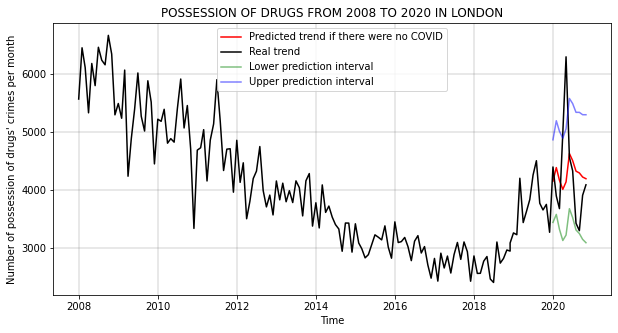

In [ ]:
#Plotting predicted values and real values from 2020
plt.figure(figsize=(10,5))
plt.plot(prediction,label="Predicted trend if there were no COVID", color='r')
plt.plot(possessionofdrugs,label="Real trend", color='black')
plt.plot(min, label="Lower prediction interval", color="g", alpha=0.5)
plt.plot(max, label="Upper prediction interval", color="b", alpha=0.5)
plt.legend(loc = 'Left corner')
plt.title("POSSESSION OF DRUGS FROM 2008 TO 2020 IN LONDON")
plt.xlabel("Time")
plt.ylabel("Number of possession of drugs' crimes per month")
plt.grid(b=True, which='major', color='#666666', linestyle='-', linewidth=0.3)
plt.show()

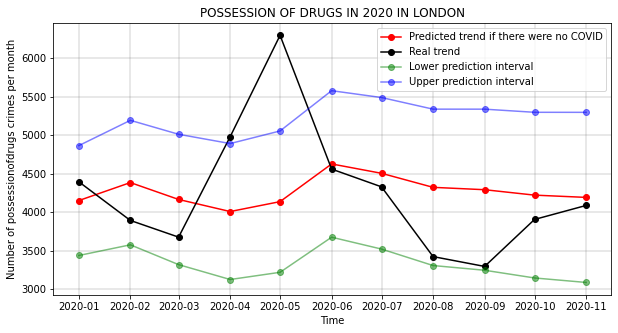

In [ ]:
import pandas as pd
possessionofdrugs.index = pd.to_datetime(possessionofdrugs.index, format='%Y%m')
possessionofdrugs_2020 = possessionofdrugs.tail(11)
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

#Plotting predicted values and real values from 2020
plt.figure(figsize=(10,5))
plt.plot(prediction.index,prediction, linestyle='-', marker='o', label="Predicted trend if there were no COVID",color='r')
plt.plot(possessionofdrugs_2020.index, possessionofdrugs_2020, label="Real trend", color='black', linestyle='-', marker='o')
plt.plot(min.index, min, label="Lower prediction interval", color="g", alpha=0.5, linestyle='-', marker='o')
plt.plot(max.index, max, label="Upper prediction interval", color="b", alpha=0.5, linestyle='-', marker='o')
plt.legend(loc = 'Left corner')
plt.title("POSSESSION OF DRUGS IN 2020 IN LONDON")
plt.xlabel("Time")
plt.ylabel("Number of possessionofdrugs crimes per month")
plt.grid(b=True, which='major', color='#666666', linestyle='-', linewidth=0.3)
plt.show()

#Predictive model: Drug trafficking

In [ ]:
# Importing necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
get_ipython().run_line_magic('matplotlib', 'inline')
import warnings
warnings.filterwarnings('ignore')

In [ ]:
#Installing pmdarima package
get_ipython().system(' pip install pmdarima')
# Importing auto_arima 
from pmdarima.arima import auto_arima

In [ ]:
#Read the crime dataset and plot it
import pandas as pd
drugtrafficking.index = pd.to_datetime(drugtrafficking.index, format='%Y%m')


In [ ]:
#Spliting the dataset into train and test 
train = drugtrafficking['2008-01-01': '2020-01-01']
test = drugtrafficking['2020-01-01':] 

In [ ]:
#Building ARIMA model 
arima_model =  auto_arima(train,start_p=0, d=1, start_q=0, 
                          max_p=5, max_d=5, max_q=5, start_P=0, 
                          D=1, start_Q=0, max_P=5, max_D=5,
                          max_Q=5, m=12, seasonal=True, 
                          error_action='warn',trace = True,
                          supress_warnings=True,stepwise = True,
                          random_state=20,n_fits = 50 )
arima_model.summary()

Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=1589.676, Time=0.03 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=1527.656, Time=0.19 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=0.65 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=1557.855, Time=0.06 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=1507.706, Time=0.57 sec
 ARIMA(1,1,0)(3,1,0)[12]             : AIC=1508.386, Time=1.16 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=1498.695, Time=2.46 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=inf, Time=0.65 sec
 ARIMA(1,1,0)(3,1,1)[12]             : AIC=inf, Time=4.59 sec
 ARIMA(1,1,0)(2,1,2)[12]             : AIC=inf, Time=3.90 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=1498.890, Time=2.88 sec
 ARIMA(1,1,0)(3,1,2)[12]             : AIC=inf, Time=8.85 sec
 ARIMA(0,1,0)(2,1,1)[12]             : AIC=1526.904, Time=1.73 sec
 ARIMA(2,1,0)(2,1,1)[12]             : AIC=inf, Time=3.13 sec
 ARIMA(1,1,1)(2,1,1)[12]             : AIC=inf, T

<class 'statsmodels.iolib.summary.Summary'>
"""
                                      SARIMAX Results                                       
============================================================================================
Dep. Variable:                                    y   No. Observations:                  146
Model:             SARIMAX(1, 1, 0)x(2, 1, [1], 12)   Log Likelihood                -744.347
Date:                              Sun, 27 Dec 2020   AIC                           1498.695
Time:                                      18:08:15   BIC                           1513.147
Sample:                                           0   HQIC                          1504.568
                                              - 146                                         
Covariance Type:                                opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.4575      0.087     -5.255      0.000      -0.628      -0.287
ar.S.L12      -0.1021      0.148     -0.691      0.490      -0.392       0.188
ar.S.L24      -0.1253      0.132     -0.950      0.342      -0.384       0.133
ma.S.L12      -0.8267      0.191     -4.323      0.000      -1.201      -0.452
sigma2      3715.1684    475.988      7.805      0.000    2782.249    4648.088
===================================================================================
Ljung-Box (L1) (Q):                   2.65   Jarque-Bera (JB):                52.71
Prob(Q):                              0.10   Prob(JB):                         0.00
Heteroskedasticity (H):               0.81   Skew:                             0.75
Prob(H) (two-sided):                  0.49   Kurtosis:                         5.70
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [ ]:
#Finding predicted crime values
prediction = pd.DataFrame(arima_model.predict(n_periods = 11),index=test.index)
prediction.columns = ['predicted_drugtrafficking']
prediction.index.name = 'MONTH'

In [ ]:
#Finding prediction interval as an array
conf_int = arima_model.predict(11,return_conf_int=True,alpha=0.05)
interval = pd.DataFrame(conf_int[1], columns = ['min','max'])

In [ ]:
#Create month column
import pandas as pd
dates = pd.DataFrame({'MONTH':['202001','202002','202003','202004','202005','202006','202007', '202008', '202009', '202010', '202011']})

In [ ]:
#Put together min max and month
table = pd.concat([dates, interval], axis=1)
#Convert the month column to datetime and set the index of the Month 
table['MONTH'] = pd.to_datetime(table['MONTH'], format='%Y%m')
table = table.set_index('MONTH') 
min = table[["min"]]
max =  table[["max"]]

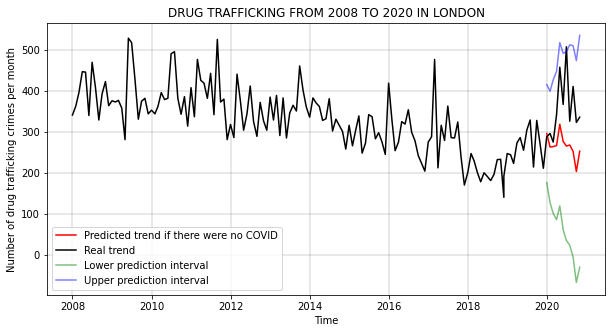

In [ ]:
#Plotting predicted values and real values from 2020
plt.figure(figsize=(10,5))
plt.plot(prediction,label="Predicted trend if there were no COVID", color='r')
plt.plot(drugtrafficking,label="Real trend", color='black')
plt.plot(min, label="Lower prediction interval", color="g", alpha=0.5)
plt.plot(max, label="Upper prediction interval", color="b", alpha=0.5)
plt.legend(loc = 'Left corner')
plt.title("DRUG TRAFFICKING FROM 2008 TO 2020 IN LONDON")
plt.xlabel("Time")
plt.ylabel("Number of drug trafficking crimes per month")
plt.grid(b=True, which='major', color='#666666', linestyle='-', linewidth=0.3)
plt.show()

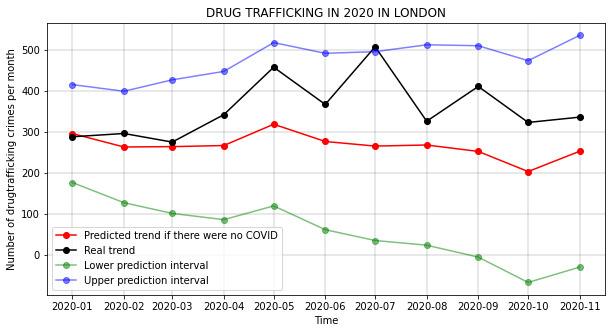

In [ ]:
import pandas as pd
drugtrafficking.index = pd.to_datetime(drugtrafficking.index, format='%Y%m')
drugtrafficking_2020 = drugtrafficking.tail(11)
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

#Plotting predicted values and real values from 2020
plt.figure(figsize=(10,5))
plt.plot(prediction.index,prediction, linestyle='-', marker='o', label="Predicted trend if there were no COVID",color='r')
plt.plot(drugtrafficking_2020.index, drugtrafficking_2020, label="Real trend", color='black', linestyle='-', marker='o')
plt.plot(min.index, min, label="Lower prediction interval", color="g", alpha=0.5, linestyle='-', marker='o')
plt.plot(max.index, max, label="Upper prediction interval", color="b", alpha=0.5, linestyle='-', marker='o')
plt.legend(loc = 'Left corner')
plt.title("DRUG TRAFFICKING IN 2020 IN LONDON")
plt.xlabel("Time")
plt.ylabel("Number of drugtrafficking crimes per month")
plt.grid(b=True, which='major', color='#666666', linestyle='-', linewidth=0.3)
plt.show()

# Predictive model: other sexual assaults

In [ ]:
# Importing necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
get_ipython().run_line_magic('matplotlib', 'inline')
import warnings
warnings.filterwarnings('ignore')

In [ ]:
#Installing pmdarima package
get_ipython().system(' pip install pmdarima')
# Importing auto_arima 
from pmdarima.arima import auto_arima

     |████████████████████████████████| 1.5MB 3.3MB/s 
     |████████████████████████████████| 2.1MB 38.2MB/s 
     |████████████████████████████████| 9.5MB 37.3MB/s 
  Found existing installation: Cython 0.29.21
    Uninstalling Cython-0.29.21:
      Successfully uninstalled Cython-0.29.21
  Found existing installation: statsmodels 0.10.2
    Uninstalling statsmodels-0.10.2:
      Successfully uninstalled statsmodels-0.10.2


MONTH,Other Sexual Offences
2020-01-01,984
2020-02-01,1129
2020-03-01,987
2020-04-01,542
2020-05-01,770
2020-06-01,900
2020-07-01,1063
2020-08-01,1055
2020-09-01,1033
2020-10-01,1087


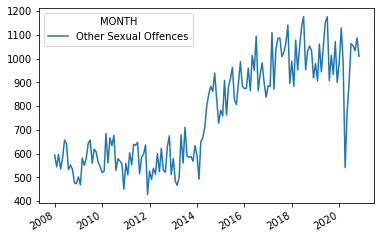

In [ ]:
#Read the crime dataset and plot it
import pandas as pd
othersexualoffences.index = pd.to_datetime(othersexualoffences.index, format='%Y%m')
othersexualoffences.plot()


In [ ]:
#Spliting the dataset into train and test 
train = othersexualoffences['2008-01-01': '2020-01-01']
test = othersexualoffences['2020-01-01':] 

In [ ]:
#Building ARIMA model 
arima_model =  auto_arima(train,start_p=0, d=1, start_q=0, 
                          max_p=5, max_d=5, max_q=5, start_P=0, 
                          D=1, start_Q=0, max_P=5, max_D=5,
                          max_Q=5, m=12, seasonal=True, 
                          error_action='warn',trace = True,
                          supress_warnings=True,stepwise = True,
                          random_state=20,n_fits = 50 )
arima_model.summary()

Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=1609.824, Time=0.11 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=1549.564, Time=0.19 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=0.66 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=1566.278, Time=0.06 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=1540.797, Time=0.58 sec
 ARIMA(1,1,0)(3,1,0)[12]             : AIC=1540.898, Time=1.21 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=inf, Time=1.69 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=inf, Time=0.54 sec
 ARIMA(1,1,0)(3,1,1)[12]             : AIC=inf, Time=3.96 sec
 ARIMA(0,1,0)(2,1,0)[12]             : AIC=1590.112, Time=0.39 sec
 ARIMA(2,1,0)(2,1,0)[12]             : AIC=1536.339, Time=0.75 sec
 ARIMA(2,1,0)(1,1,0)[12]             : AIC=1545.050, Time=0.28 sec
 ARIMA(2,1,0)(3,1,0)[12]             : AIC=1536.737, Time=1.50 sec
 ARIMA(2,1,0)(2,1,1)[12]             : AIC=inf, Time=2.30 sec
 ARIMA(2,1,0)(1,1,1)[12]             : AIC=i

<class 'statsmodels.iolib.summary.Summary'>
"""
                                      SARIMAX Results                                      
===========================================================================================
Dep. Variable:                                   y   No. Observations:                  146
Model:             SARIMAX(3, 1, 3)x(2, 1, [], 12)   Log Likelihood                -752.623
Date:                             Sun, 27 Dec 2020   AIC                           1523.245
Time:                                     18:04:56   BIC                           1549.258
Sample:                                          0   HQIC                          1533.816
                                             - 146                                         
Covariance Type:                               opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.7907      0.125    -14.315      0.000      -2.036      -1.546
ar.L2         -1.0455      0.230     -4.541      0.000      -1.497      -0.594
ar.L3         -0.1910      0.147     -1.298      0.194      -0.479       0.097
ma.L1          1.1065      0.116      9.508      0.000       0.878       1.335
ma.L2         -0.1682      0.174     -0.964      0.335      -0.510       0.174
ma.L3         -0.5014      0.117     -4.290      0.000      -0.730      -0.272
ar.S.L12      -0.6089      0.094     -6.482      0.000      -0.793      -0.425
ar.S.L24      -0.3902      0.105     -3.723      0.000      -0.596      -0.185
sigma2      4629.9096    632.789      7.317      0.000    3389.665    5870.154
===================================================================================
Ljung-Box (L1) (Q):                   0.04   Jarque-Bera (JB):                 0.86
Prob(Q):                              0.85   Prob(JB):                         0.65
Heteroskedasticity (H):               3.50   Skew:                             0.19
Prob(H) (two-sided):                  0.00   Kurtosis:                         3.12
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [ ]:
#Finding predicted crime values
prediction = pd.DataFrame(arima_model.predict(n_periods = 11),index=test.index)
prediction.columns = ['predicted_othersexualoffences']
prediction.index.name = 'MONTH'
prediction

,predicted_othersexualoffences
MONTH,
2020-01-01,1014.680664
2020-02-01,1036.938401
2020-03-01,1002.407419
2020-04-01,1145.695994
2020-05-01,1142.484753
2020-06-01,1111.697062
2020-07-01,1001.826894
2020-08-01,1084.350933
2020-09-01,1063.488339


In [ ]:
#Finding prediction interval as an array
conf_int = arima_model.predict(11,return_conf_int=True,alpha=0.05)
interval = pd.DataFrame(conf_int[1], columns = ['min','max'])

In [ ]:
#Create month column
import pandas as pd
dates = pd.DataFrame({'MONTH':['202001','202002','202003','202004','202005','202006','202007', '202008', '202009', '202010', '202011']})

In [ ]:
#Put together min max and month
table = pd.concat([dates, interval], axis=1)
#Convert the month column to datetime and set the index of the Month 
table['MONTH'] = pd.to_datetime(table['MONTH'], format='%Y%m')
table = table.set_index('MONTH') 
min = table[["min"]]
max =  table[["max"]]


,min,max
MONTH,,
2020-01-01,881.317974,1148.043353
2020-02-01,897.082257,1176.794545
2020-03-01,855.900032,1148.914806
2020-04-01,992.730786,1298.661202
2020-05-01,978.459037,1306.510468
2020-06-01,944.713520,1278.680604
2020-07-01,822.530551,1181.123237
2020-08-01,902.447796,1266.254071
2020-09-01,871.166552,1255.810127


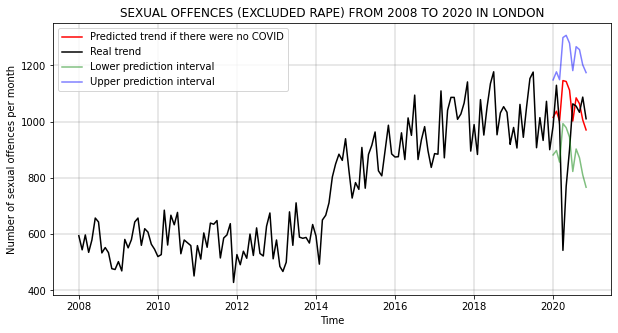

In [ ]:
#Plotting predicted values and real values from 2020
plt.figure(figsize=(10,5))
plt.plot(prediction,label="Predicted trend if there were no COVID", color='r')
plt.plot(othersexualoffences,label="Real trend", color='black')
plt.plot(min, label="Lower prediction interval", color="g", alpha=0.5)
plt.plot(max, label="Upper prediction interval", color="b", alpha=0.5)
plt.legend(loc = 'Left corner')
plt.title("SEXUAL OFFENCES (EXCLUDED RAPE) FROM 2008 TO 2020 IN LONDON")
plt.xlabel("Time")
plt.ylabel("Number of sexual offences per month")
plt.grid(b=True, which='major', color='#666666', linestyle='-', linewidth=0.3)
plt.show()

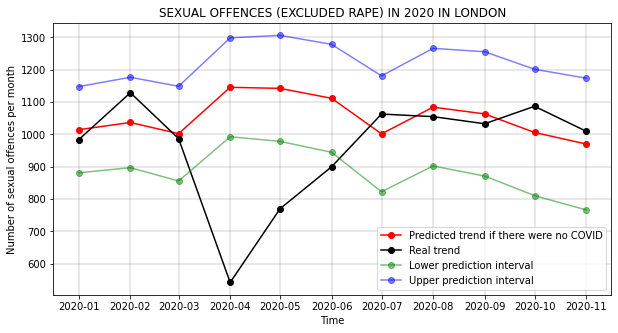

In [ ]:
import pandas as pd
othersexualoffences.index = pd.to_datetime(othersexualoffences.index, format='%Y%m')
othersexualoffences_2020 = othersexualoffences.tail(11)
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

#Plotting predicted values and real values from 2020
plt.figure(figsize=(10,5))
plt.plot(prediction.index,prediction, linestyle='-', marker='o', label="Predicted trend if there were no COVID",color='r')
plt.plot(othersexualoffences_2020.index, othersexualoffences_2020, label="Real trend", color='black', linestyle='-', marker='o')
plt.plot(min.index, min, label="Lower prediction interval", color="g", alpha=0.5, linestyle='-', marker='o')
plt.plot(max.index, max, label="Upper prediction interval", color="b", alpha=0.5, linestyle='-', marker='o')
plt.legend(loc = 'Left corner')
plt.title("SEXUAL OFFENCES (EXCLUDED RAPE) IN 2020 IN LONDON")
plt.xlabel("Time")
plt.ylabel("Number of sexual offences per month")
plt.grid(b=True, which='major', color='#666666', linestyle='-', linewidth=0.3)
plt.show()

# Predictive model: Rape

Repeat this process for all 4 types of crime

In [ ]:
# Importing necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
get_ipython().run_line_magic('matplotlib', 'inline')
import warnings
warnings.filterwarnings('ignore')

In [ ]:
#Installing pmdarima package
get_ipython().system(' pip install pmdarima')
# Importing auto_arima 
from pmdarima.arima import auto_arima

In [ ]:
# Importing auto_arima 
from pmdarima.arima import auto_arima

In [ ]:
#Read the crime dataset 
import pandas as pd
rape.index = pd.to_datetime(rape.index, format='%Y%m')
rape.tail(11)


MONTH,Rape
2020-01-01,724
2020-02-01,669
2020-03-01,556
2020-04-01,447
2020-05-01,508
2020-06-01,626
2020-07-01,742
2020-08-01,634
2020-09-01,661
2020-10-01,655


In [ ]:
#Testing for stationarity --> it should say 'False'
from pmdarima.arima import ADFTest
adf_test = ADFTest(alpha = 0.05)
adf_test.should_diff(rape)

(0.3906450836362534, True)

Because this is a time series forecast, we will “chop off” a portion of our latest data and use that as the test set. Then we will train on the rest of the data and forecast into the future. Afterwards we can compare our forecast with the section of data we chopped off.

In [ ]:
#Spliting the dataset into train and test 
train = rape['2008-01-01': '2020-01-01']
test = rape['2020-01-01':] 


In [ ]:
len(train)

146

In [ ]:
#Building ARIMA model 
arima_model =  auto_arima(train,start_p=0, d=1, start_q=0, 
                          max_p=5, max_d=5, max_q=5, start_P=0, 
                          D=1, start_Q=0, max_P=5, max_D=5,
                          max_Q=5, m=12, seasonal=True, 
                          error_action='warn',trace = True,
                          supress_warnings=True,stepwise = True,
                          random_state=20,n_fits = 50 )
arima_model.summary()

Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=1460.148, Time=0.02 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=1419.592, Time=0.16 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=1383.083, Time=0.45 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=1424.120, Time=0.06 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=inf, Time=0.87 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=inf, Time=1.81 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=1405.226, Time=0.26 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=inf, Time=2.67 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=1419.941, Time=0.21 sec
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=1385.037, Time=0.86 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=1385.023, Time=0.79 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=1398.071, Time=0.29 sec
 ARIMA(1,1,2)(0,1,1)[12]             : AIC=1385.694, Time=0.62 sec
 ARIMA(0,1,1)(0,1,1)[12] intercept   : AIC=1384.970, Time=0.45 sec

Best model:  ARIMA(0,1,1)(0,1,1)[

<class 'statsmodels.iolib.summary.Summary'>
"""
                                     SARIMAX Results                                      
==========================================================================================
Dep. Variable:                                  y   No. Observations:                  146
Model:             SARIMAX(0, 1, 1)x(0, 1, 1, 12)   Log Likelihood                -688.541
Date:                            Sat, 26 Dec 2020   AIC                           1383.083
Time:                                    17:16:20   BIC                           1391.754
Sample:                                         0   HQIC                          1386.606
                                            - 146                                         
Covariance Type:                              opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.6004      0.051    -11.887      0.000      -0.699      -0.501
ma.S.L12      -0.7988      0.075    -10.587      0.000      -0.947      -0.651
sigma2      1671.8648    167.739      9.967      0.000    1343.101    2000.628
===================================================================================
Ljung-Box (L1) (Q):                   0.01   Jarque-Bera (JB):                 6.37
Prob(Q):                              0.94   Prob(JB):                         0.04
Heteroskedasticity (H):               6.07   Skew:                             0.03
Prob(H) (two-sided):                  0.00   Kurtosis:                         4.07
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [ ]:
#Finding predicted crime values
prediction = pd.DataFrame(arima_model.predict(n_periods = 11),index=test.index)
prediction.columns = ['predicted_rape']
prediction.index.name = 'MONTH'


In [ ]:
#Finding prediction interval as an array
conf_int = arima_model.predict(11,return_conf_int=True,alpha=0.05)
interval = pd.DataFrame(conf_int[1], columns = ['min','max'])

In [ ]:
#Create month column
import pandas as pd
dates = pd.DataFrame({'MONTH':['202001','202002','202003','202004','202005','202006','202007', '202008', '202009', '202010', '202011']})

In [ ]:
#Put together min max and month
table = pd.concat([dates, interval], axis=1)
#Convert the month column to datetime and set the index of the Month 
table['MONTH'] = pd.to_datetime(table['MONTH'], format='%Y%m')
table = table.set_index('MONTH') 
min = table[["min"]]
max =  table[["max"]]
table

,min,max
MONTH,,
2020-01-01,638.903078,799.321729
2020-02-01,603.235333,775.985713
2020-03-01,649.067815,833.326428
2020-04-01,644.808858,839.898015
2020-05-01,673.214219,878.563487
2020-06-01,628.038607,843.159189
2020-07-01,617.201610,841.668551
2020-08-01,618.174797,851.614190
2020-09-01,631.867444,873.946961


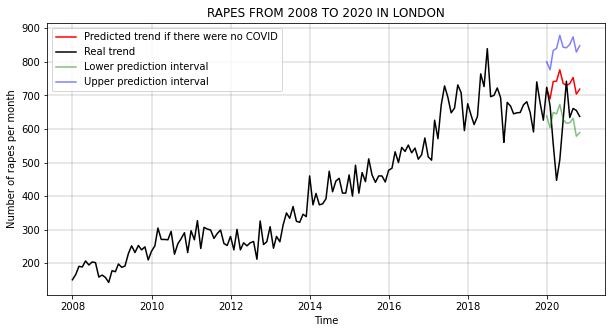

In [ ]:
#Plotting predicted values and real values from 2020
plt.figure(figsize=(10,5))
plt.plot(prediction,label="Predicted trend if there were no COVID",color='r')
plt.plot(rape,label="Real trend", color='black')
plt.plot(min, label="Lower prediction interval", color="g", alpha=0.5)
plt.plot(max, label="Upper prediction interval", color="b", alpha=0.5)
plt.legend(loc = 'Left corner')
plt.title("RAPES FROM 2008 TO 2020 IN LONDON")
plt.xlabel("Time")
plt.ylabel("Number of rapes per month")
plt.grid(b=True, which='major', color='#666666', linestyle='-', linewidth=0.3)
plt.show()

In [ ]:
import pandas as pd
rape.index = pd.to_datetime(rape.index, format='%Y%m')
rape_2020 = rape.tail(11)

MONTH,Rape
2020-01-01,724
2020-02-01,669
2020-03-01,556
2020-04-01,447
2020-05-01,508
2020-06-01,626
2020-07-01,742
2020-08-01,634
2020-09-01,661
2020-10-01,655


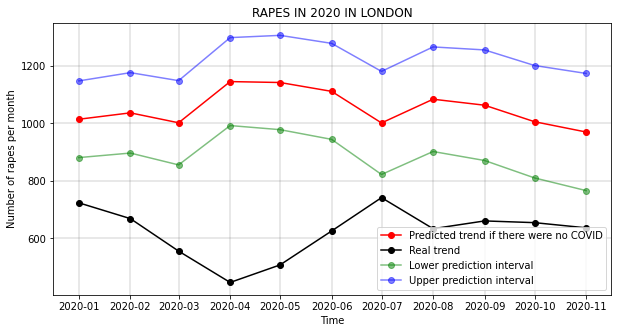

In [ ]:
import pandas as pd
rape.index = pd.to_datetime(rape.index, format='%Y%m')
rape_2020 = rape.tail(11)
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

#Plotting predicted values and real values from 2020
plt.figure(figsize=(10,5))
plt.plot(prediction.index,prediction, linestyle='-', marker='o', label="Predicted trend if there were no COVID",color='r')
plt.plot(rape_2020.index, rape_2020, label="Real trend", color='black', linestyle='-', marker='o')
plt.plot(min.index, min, label="Lower prediction interval", color="g", alpha=0.5, linestyle='-', marker='o')
plt.plot(max.index, max, label="Upper prediction interval", color="b", alpha=0.5, linestyle='-', marker='o')
plt.legend(loc = 'Left corner')
plt.title("RAPES IN 2020 IN LONDON")
plt.xlabel("Time")
plt.ylabel("Number of rapes per month")
plt.grid(b=True, which='major', color='#666666', linestyle='-', linewidth=0.3)
plt.show()

#Testing the accuracy of the model

In [ ]:
# Importing necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
get_ipython().run_line_magic('matplotlib', 'inline')
import warnings
warnings.filterwarnings('ignore')

In [ ]:
#Installing pmdarima package
get_ipython().system(' pip install pmdarima')

In [ ]:
# Importing auto_arima 
from pmdarima.arima import auto_arima

In [ ]:
#Read the crime dataset 
residentialburglary_accuracy = residentialburglary.head(145)
residentialburglary_accuracy.tail()

MONTH,Burglary - Residential
201908,4417
201909,4858
201910,5468
201911,5431
201912,5286


In [ ]:
#Testing for stationarity --> it should say 'False'
from pmdarima.arima import ADFTest
adf_test = ADFTest(alpha = 0.05)
adf_test.should_diff(residentialburglary_accuracy)

(0.0918086053440279, True)

In [ ]:
#Spliting the dataset into train and test 
train = residentialburglary_accuracy['200801': '201901']
test = residentialburglary_accuracy['201901':]

In [ ]:
len(test)

12

In [ ]:
#Building ARIMA model 
arima_model =  auto_arima(train,start_p=0, d=1, start_q=0, 
                          max_p=5, max_d=5, max_q=5, start_P=0, 
                          D=1, start_Q=0, max_P=5, max_D=5,
                          max_Q=5, m=12, seasonal=True, 
                          error_action='warn',trace = True,
                          supress_warnings=True,stepwise = True,
                          random_state=20,n_fits = 50 )
arima_model.summary()

Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=1808.036, Time=0.02 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=1757.690, Time=0.22 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=1736.229, Time=0.84 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=1784.073, Time=0.04 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=1737.724, Time=1.20 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=1737.688, Time=2.06 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=1751.839, Time=0.25 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=inf, Time=3.83 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=1753.414, Time=0.26 sec
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=1738.213, Time=0.66 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=1738.203, Time=0.90 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=1740.331, Time=0.70 sec
 ARIMA(1,1,2)(0,1,1)[12]             : AIC=inf, Time=0.94 sec
 ARIMA(0,1,1)(0,1,1)[12] intercept   : AIC=1737.917, Time=0.90 sec

Best model:  ARIMA(0,1,1)(0,

<class 'statsmodels.iolib.summary.Summary'>
"""
                                     SARIMAX Results                                      
==========================================================================================
Dep. Variable:                                  y   No. Observations:                  134
Model:             SARIMAX(0, 1, 1)x(0, 1, 1, 12)   Log Likelihood                -865.114
Date:                            Mon, 21 Dec 2020   AIC                           1736.229
Time:                                    21:42:03   BIC                           1744.616
Sample:                                         0   HQIC                          1739.635
                                            - 134                                         
Covariance Type:                              opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.4146      0.066     -6.256      0.000      -0.544      -0.285
ma.S.L12      -0.7959      0.123     -6.446      0.000      -1.038      -0.554
sigma2      8.406e+04   9482.028      8.865      0.000    6.55e+04    1.03e+05
===================================================================================
Ljung-Box (L1) (Q):                   0.01   Jarque-Bera (JB):                 9.63
Prob(Q):                              0.93   Prob(JB):                         0.01
Heteroskedasticity (H):               0.99   Skew:                             0.17
Prob(H) (two-sided):                  0.99   Kurtosis:                         4.34
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [ ]:
#Finding predicted crime values
prediction2019 = pd.DataFrame(arima_model.predict(n_periods = 12),index=test.index)
prediction2019.columns = ['predicted_residentialburglary']
prediction2019

,predicted_residentialburglary
201901,5287.444943
201902,4895.160688
201903,4883.732202
201904,4772.050490
201905,4869.554847
201906,4951.089243
201907,4887.789416
201908,5493.104438
201909,6179.755049
201910,5966.699849


In [ ]:
#Finding prediction interval as dataframe
conf_int2019 = arima_model.predict(12,return_conf_int=True,alpha=0.05)
interval2019 = pd.DataFrame(conf_int2019[1], columns = ['min','max'])
interval2019

,min,max
0,4718.528251,5856.361635
1,4235.915885,5554.405492
2,4145.127126,5622.337279
3,3961.821456,5582.279524
4,3993.538459,5745.571236
5,4013.892178,5888.286308
6,3893.167898,5882.410934
7,4444.197582,6542.011294
8,5079.237299,7280.272799
9,4816.885532,7116.514165


In [ ]:
#Create month column
import pandas as pd
dates2019 = pd.DataFrame({'MONTH':['201901','201901','202003','201904','201905','201906','201907', '201908', '201909', '201910', '201911', '201912']})
dates2019.head()

,MONTH
0,201901
1,201901
2,202003
3,201904
4,201905


In [ ]:
#Put together min max and month
table2019 = pd.concat([dates2019, interval2019], axis=1)
table2019

,MONTH,min,max
0,201901,4718.528251,5856.361635
1,201901,4235.915885,5554.405492
2,202003,4145.127126,5622.337279
3,201904,3961.821456,5582.279524
4,201905,3993.538459,5745.571236
5,201906,4013.892178,5888.286308
6,201907,3893.167898,5882.410934
7,201908,4444.197582,6542.011294
8,201909,5079.237299,7280.272799
9,201910,4816.885532,7116.514165


In [ ]:
#Convert the month column to datetime and set the index of the Month 
table2019.set_index('MONTH',inplace=True) 

In [ ]:
#write values as lists
import pandas as pd
prediction2019_list = prediction2019['predicted_residentialburglary'].values.tolist()
residentialburglary_short = residentialburglary_accuracy.tail(12)
residentialburglary_list = residentialburglary_short['Burglary - Residential'].values.tolist()


In [ ]:
#calculate rmse
from math import sqrt
from sklearn.metrics import mean_squared_error
rms = sqrt(mean_squared_error(residentialburglary_list, prediction2019_list))
print(rms)


612.6433904306639


In [ ]:
#calculate mean absolute error
from math import sqrt
from sklearn.metrics import mean_absolute_error
mae = sqrt(mean_absolute_error(residentialburglary_list, prediction2019_list))
print(mae)

22.470514338208194


In [ ]:
#calculate mean absolute percentage error
import numpy as np
def mean_absolute_percentage_error(residentialburglary_list, prediction2019_list): 
    residentialburglary_list, prediction2019_list = np.array(residentialburglary_list), np.array(prediction2019_list)
    return np.mean(np.abs((residentialburglary_list - prediction2019_list) / residentialburglary_list)) * 100
mean_absolute_percentage_error(residentialburglary_list, prediction2019_list)

10.316426320082638

In [ ]:
#Plotting predicted values and real values from 2019
plt.figure(figsize=(8,5))
plt.plot(prediction2019,label="Predicted trend")
plt.plot(data2019,label="Real trend")
plt.plot(table, label="Prediction interval", color='red')
plt.legend(loc = 'Left corner')
plt.title("RAPE FROM 2015 TO 2019 IN LONDON")
plt.xlabel("Time")
plt.ylabel("Monthly rape values")
plt.grid(b=True, which='major', color='#666666', linestyle='-', linewidth=0.3)
plt.show()

NameError: ignored

<Figure size 576x360 with 0 Axes>

In [ ]:
#calculate rmse
from math import sqrt
from sklearn.metrics import mean_squared_error
rms = sqrt(mean_squared_error(dataset_accuracy_list, prediction2019_list))
print(rms)

72.17261774090233


In [ ]:
#calculate rmse
from math import sqrt
from sklearn.metrics import mean_squared_error
mae = sqrt(mean_absolute_error(dataset_accuracy_list, prediction2019_list))
print(rms)

# Folium map

In [ ]:
# Importing the librairies we need
import pandas as pd
import numpy as np
from sklearn import preprocessing
!pip install --upgrade geopandas
import geopandas as gpd
import folium
import folium.plugins
import os

     |████████████████████████████████| 972kB 5.9MB/s 
     |████████████████████████████████| 14.8MB 232kB/s 
     |████████████████████████████████| 6.5MB 49.4MB/s 


In [ ]:
# Reshaping the files
crime = pd.read_csv("/content/data/MPS Borough Level Crime (most recent 24 months).csv", index_col=0)
crime

,MinorText,LookUp_BoroughName,201812,201901,201902,201903,201904,201905,201906,201907,201908,201909,201910,201911,201912,202001,202002,202003,202004,202005,202006,202007,202008,202009,202010,202011
MajorText,,,,,,,,,,,,,,,,,,,,,,,,,,
Arson and Criminal Damage,Arson,Barking and Dagenham,1,5,2,5,5,11,3,5,3,6,9,8,6,4,5,6,2,2,4,4,6,2,7,4
Arson and Criminal Damage,Criminal Damage,Barking and Dagenham,88,97,127,138,130,140,113,134,118,109,109,97,122,97,103,107,80,86,121,122,114,116,119,100
Burglary,Burglary - Business and Community,Barking and Dagenham,33,45,24,29,27,21,27,31,35,37,30,30,26,31,17,28,29,16,16,28,24,32,21,19
Burglary,Burglary - Residential,Barking and Dagenham,164,114,107,99,96,114,96,71,67,80,97,114,130,116,123,97,57,42,63,72,63,54,67,90
Drug Offences,Drug Trafficking,Barking and Dagenham,4,6,2,6,5,9,6,11,8,7,9,12,3,16,6,6,15,13,12,21,9,11,14,17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Vehicle Offences,Theft from a Motor Vehicle,Westminster,274,356,287,334,266,284,304,266,250,270,352,301,382,317,345,230,58,100,168,279,367,312,240,134
Vehicle Offences,Theft or Taking of a Motor Vehicle,Westminster,36,65,48,54,71,51,57,71,63,55,56,58,53,75,56,53,32,40,35,56,57,48,66,58
Violence Against the Person,Homicide,Westminster,0,1,0,2,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,1,1,0,0,1


In [ ]:
# Renaming and deleting some columns and lines
crime.rename(columns={"LookUp_BoroughName": "Boroughs"}, inplace=True)
crime.rename(columns={"MajorText": "Crime type"}, inplace=True)

crime.drop (['MinorText', "201812", "201901", "201902", "201903", "201904", "201905", "201906", "201907", "201908", "201909", "201910", "201911", "201912"], axis=1, inplace=True)

crime.drop(
    labels=["Arson and Criminal Damage", "Miscellaneous Crimes Against Society", "Possession of Weapons", "Public Order Offences", "Robbery", "Theft", "Vehicle Offences", "Violence Against the Person"],
    axis=0,
    inplace=True
)
crime.head()

,Boroughs,202001,202002,202003,202004,202005,202006,202007,202008,202009,202010,202011
MajorText,,,,,,,,,,,,
Burglary,Barking and Dagenham,31,17,28,29,16,16,28,24,32,21,19
Burglary,Barking and Dagenham,116,123,97,57,42,63,72,63,54,67,90
Drug Offences,Barking and Dagenham,16,6,6,15,13,12,21,9,11,14,17
Drug Offences,Barking and Dagenham,99,106,112,145,182,192,117,81,94,142,127
Sexual Offences,Barking and Dagenham,26,39,36,16,17,21,41,33,29,39,36


In [ ]:
# Grouping numbers per borough and main crime type (as we have multiple lines for each crime type since theyy have subcategories which we deleted earlier)
cleancrime = crime.groupby(['MajorText','Boroughs']).sum().reset_index()

In [ ]:
# Summing the values of every months of 2020  to get a number for each borough for the whole year
cleancrime['Total'] = cleancrime.loc[:,['202001', '202002', '202003', '202004', '202005', '202006', '202007', '202008', '202009', '202010', '202011']].sum(axis=1)
cleancrime.head()

,MajorText,Boroughs,202001,202002,202003,202004,202005,202006,202007,202008,202009,202010,202011,Total
0,Burglary,Barking and Dagenham,147,140,125,86,58,79,100,87,86,88,109,1105
1,Burglary,Barnet,302,292,255,125,158,168,190,241,255,311,310,2607
2,Burglary,Bexley,185,147,97,50,64,57,63,60,80,78,91,972
3,Burglary,Brent,233,215,173,129,150,157,176,198,175,209,175,1990
4,Burglary,Bromley,238,258,177,123,104,114,109,114,108,134,143,1622


In [ ]:
# Deleting the values of each months as we don't need them anymore
cleancrime.drop (['202001', '202002', '202003', '202004', '202005', '202006', '202007', '202008', '202009', '202010', '202011'], axis=1, inplace=True)

In [ ]:
# Creating a dataframe for Burglary
burglary= cleancrime.iloc[0:33]
burglary.drop (["MajorText"], axis=1, inplace=True)
pd.set_option("display.max_rows", None, "display.max_columns", None)
burglary

/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:4174: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


,Boroughs,Total
0,Barking and Dagenham,1105
1,Barnet,2607
2,Bexley,972
3,Brent,1990
4,Bromley,1622
5,Camden,2134
6,Croydon,2188
7,Ealing,2027
8,Enfield,2264
9,Greenwich,1524


In [ ]:
# Normalizing for burglary
x_array = np.array(burglary['Total'])
normalizedburglary = preprocessing.normalize([x_array])

In [ ]:
# Putting the normalized data into a dataframe
normalized_burglary = pd.DataFrame(normalizedburglary)
normalized_burglary = normalized_burglary.T 
normalized_burglary.columns = ['Normalized Total']
normalized_burglary

,Normalized Total
0,0.105723
1,0.249430
2,0.092998
3,0.190397
4,0.155188
5,0.204175
6,0.209342
7,0.193938
8,0.216613
9,0.145812


In [ ]:
# Adding the borough to the new normalized dataframe
burglary.drop (['Total'], axis=1, inplace=True)

normalized_burglary_with_borough = pd.concat([burglary, normalized_burglary], axis=1)
normalized_burglary_with_borough

/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:4174: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


,Boroughs,Normalized Total
0,Barking and Dagenham,0.105723
1,Barnet,0.249430
2,Bexley,0.092998
3,Brent,0.190397
4,Bromley,0.155188
5,Camden,0.204175
6,Croydon,0.209342
7,Ealing,0.193938
8,Enfield,0.216613
9,Greenwich,0.145812


In [ ]:
# Creating a dataframe for Drug offences
drugoffence= cleancrime.iloc[33:66]
drugoffence.drop (["MajorText"], axis=1, inplace=True)
pd.set_option("display.max_rows", None, "display.max_columns", None)
drugoffence

/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:4174: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


,Boroughs,Total
33,Barking and Dagenham,1537
34,Barnet,1077
35,Bexley,767
36,Brent,2049
37,Bromley,1140
38,Camden,1869
39,Croydon,2594
40,Ealing,2068
41,Enfield,1419
42,Greenwich,1798


In [ ]:
# Normalizing for drug offences
y_array = np.array(drugoffence['Total'])
normalizeddrugoffence = preprocessing.normalize([y_array])

In [ ]:
# Putting the normalized data into a dataframe
normalized_drugoffence = pd.DataFrame(normalizeddrugoffence)
normalized_drugoffence = normalized_drugoffence.T 
normalized_drugoffence.columns = ['Normalized Total']
normalized_drugoffence

,Normalized Total
0,0.159294
1,0.111620
2,0.079491
3,0.212357
4,0.118149
5,0.193702
6,0.268840
7,0.214326
8,0.147064
9,0.186343


In [ ]:
# Adding the borough to the new normalized dataframe
drugoffence.drop (['Total'], axis=1, inplace=True)
drugoffence.reset_index(drop=True, inplace=True)

normalized_drugoffence_with_borough = pd.concat([drugoffence, normalized_drugoffence], axis=1)
normalized_drugoffence_with_borough

/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:4174: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


,Boroughs,Normalized Total
0,Barking and Dagenham,0.159294
1,Barnet,0.111620
2,Bexley,0.079491
3,Brent,0.212357
4,Bromley,0.118149
5,Camden,0.193702
6,Croydon,0.268840
7,Ealing,0.214326
8,Enfield,0.147064
9,Greenwich,0.186343


In [ ]:
# Creating a dataframe for Sexual offences
sexualoffence= cleancrime.iloc[66:99]
sexualoffence.drop (["MajorText"], axis=1, inplace=True)
pd.set_option("display.max_rows", None, "display.max_columns", None)
sexualoffence

/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:4174: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


,Boroughs,Total
66,Barking and Dagenham,559
67,Barnet,503
68,Bexley,341
69,Brent,551
70,Bromley,463
71,Camden,530
72,Croydon,934
73,Ealing,665
74,Enfield,606
75,Greenwich,649


In [ ]:
# Normalizing for sexualoffences
z_array = np.array(sexualoffence['Total'])
normalizedsexualoffence = preprocessing.normalize([z_array])

In [ ]:
# Putting the normalized data into a dataframe
normalized_sexualoffence = pd.DataFrame(normalizedsexualoffence)
normalized_sexualoffence = normalized_sexualoffence.T 
normalized_sexualoffence.columns = ['Normalized Total']
normalized_sexualoffence

,Normalized Total
0,0.173100
1,0.155759
2,0.105594
3,0.170622
4,0.143372
5,0.164119
6,0.289222
7,0.205923
8,0.187654
9,0.200969


In [ ]:
# Adding the borough to the new normalized dataframe
sexualoffence.drop (['Total'], axis=1, inplace=True)
sexualoffence.reset_index(drop=True, inplace=True)

normalized_sexualoffence_with_borough = pd.concat([sexualoffence, normalized_sexualoffence], axis=1)
normalized_sexualoffence_with_borough

/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:4174: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


,Boroughs,Normalized Total
0,Barking and Dagenham,0.173100
1,Barnet,0.155759
2,Bexley,0.105594
3,Brent,0.170622
4,Bromley,0.143372
5,Camden,0.164119
6,Croydon,0.289222
7,Ealing,0.205923
8,Enfield,0.187654
9,Greenwich,0.200969


In [ ]:
# Reshaping the COVID-19 cases datasets
covidcases = pd.read_csv("/content/data/phe_cases_london_boroughs.csv")
covidcases

,area_name,area_code,date,new_cases,total_cases
0,Barking and Dagenham,E09000002,2020-02-11,0,0
1,Barnet,E09000003,2020-02-11,0,0
2,Bexley,E09000004,2020-02-11,0,0
3,Brent,E09000005,2020-02-11,0,0
4,Bromley,E09000006,2020-02-11,0,0
5,Camden,E09000007,2020-02-11,0,0
6,Croydon,E09000008,2020-02-11,0,0
7,Ealing,E09000009,2020-02-11,0,0
8,Enfield,E09000010,2020-02-11,0,0
9,Greenwich,E09000011,2020-02-11,0,0


In [ ]:
# Deleting the lines that deal with December COVID-19 cases and selecting the columns we need
covidcases.drop(covidcases.index[0:9664], inplace=True)
clean = covidcases[['area_name','total_cases']]
pd.set_option("display.max_rows", None, "display.max_columns", None)
clean

,area_name,total_cases
9664,Barking and Dagenham,5578
9665,Barnet,8005
9666,Bexley,5806
9667,Brent,7268
9668,Bromley,6056
9669,Camden,3952
9670,Croydon,7097
9671,Ealing,8731
9672,Enfield,7403
9673,Greenwich,5184


In [ ]:
# Normalizing covid cases
c_array = np.array(covidcases['total_cases'])
normalizedcovid = preprocessing.normalize([c_array])

In [ ]:
# Putting the normalized data into a dataframe
normalized_covid = pd.DataFrame(normalizedcovid)
normalized_covid = normalized_covid.T 
normalized_covid.columns = ['Normalized Total']
normalized_covid

,Normalized Total
0,0.161399
1,0.231625
2,0.167997
3,0.210300
4,0.175230
5,0.114351
6,0.205352
7,0.252632
8,0.214206
9,0.149999


In [ ]:
# Adding the borough to the new normalized dataframe
clean.drop (['total_cases'], axis=1, inplace=True)
clean.reset_index(drop=True, inplace=True)

normalized_covid_with_borough = pd.concat([clean, normalized_covid], axis=1)
normalized_covid_with_borough

/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:4174: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


,area_name,Normalized Total
0,Barking and Dagenham,0.161399
1,Barnet,0.231625
2,Bexley,0.167997
3,Brent,0.210300
4,Bromley,0.175230
5,Camden,0.114351
6,Croydon,0.205352
7,Ealing,0.252632
8,Enfield,0.214206
9,Greenwich,0.149999


In [ ]:
# Create Dualmap object
m = folium.plugins.DualMap(location=[51.5074, 0.1278], zoom_start=10)

In [ ]:
# Joining our data for the map (especially the shape file in .json)
boroughs = os.path.join("london_boroughs.json")
boroughsdata = gpd.read_file("/content/london_boroughs.json")
covid = os.path.join("content", "phe_cases_london_boroughs.csv")
crime1 = os.path.join("content", "MPS Borough Level Crime (most recent 24 months).csv")

In [ ]:
# Fitting our shape .json file into the map
boroughsdata['geometry'] = boroughsdata['geometry'].to_crs(epsg=4326)
boroughsdata.to_file("london-borough.json", driver="GeoJSON")

In [ ]:
# Creating the COVID-19 choropleth layer for the map on the left
folium.Choropleth(
    geo_data=boroughsdata,
    name='COVID-19 infections',
    data=normalized_covid_with_borough,
    columns=['area_name', 'Normalized Total'],
    key_on='properties.name',
    fill_color='Blues',
    fill_opacity=0.7,
    line_opacity=0.5,
    bins=6,
    nan_fill_color='White',
    nan_fill_opacity=0.8,
    legend_name='Covid infections',
    overlay=True,
    show=True
).add_to(m.m1)

In [ ]:
# Creating the Sexual Offence choropleth layer for the map on the right
folium.Choropleth(
    geo_data=boroughsdata,
    name='Sexual offences',
    data=normalized_sexualoffence_with_borough,
    columns=['Boroughs', 'Normalized Total'],
    key_on='properties.name',
    fill_color='Reds',
    fill_opacity=0.7,
    line_opacity=0.5,
    bins=6,
    nan_fill_color='White',
    nan_fill_opacity=0.8,
    legend_name='Sexual offences',
    overlay=True,
    show=False
).add_to(m.m2)

In [ ]:
# Creating the Drug Offence choropleth layer for the map on the right
folium.Choropleth(
    geo_data=boroughsdata,
    name='Drug offences',
    data=normalized_drugoffence_with_borough,
    columns=['Boroughs', 'Normalized Total'],
    key_on='properties.name',
    fill_color='Greens',
    fill_opacity=0.7,
    line_opacity=0.5,
    bins=6,
    nan_fill_color='White',
    nan_fill_opacity=0.8,
    legend_name='Drug offences',
    overlay=True,
    show=True
).add_to(m.m2)

In [ ]:
# Creating the Burglary choropleth layer for the map on the right
folium.Choropleth(
    geo_data=boroughsdata,
    name='Burglary',
    data=normalized_burglary_with_borough,
    columns=['Boroughs', 'Normalized Total'],
    key_on='properties.name',
    fill_color='Purples',
    fill_opacity=0.7,
    line_opacity=0.5,
    bins=6,
    nan_fill_color='White',
    nan_fill_opacity=0.8,
    legend_name='Burglaries',
    overlay=True,
    show=False
).add_to(m.m2)

In [ ]:
# Displaying the boroughs on the map on the left
mnames=folium.GeoJson(
    data=boroughsdata,
    name="Map of London Boroughs",
    style_function = lambda feature: dict(fillColor= '#00000000', color= '#00000000', weight=0, opacity=-1000),
    overlay=True,
    control=False,
    show=True,
    tooltip=folium.features.GeoJsonTooltip(
            fields=['name'],
            labels=False)
).add_to(m.m1)
m.m1.keep_in_front(mnames)


In [ ]:
# Displaying the boroughs on the map on the right
mnames=folium.GeoJson(
    data=boroughsdata,
    name="Map of London Boroughs",
    style_function = lambda feature: dict(fillColor= '#00000000', color= '#00000000', weight=0, opacity=-1000),
    overlay=True,
    control=False,
    show=True,
    tooltip=folium.features.GeoJsonTooltip(
            fields=['name'],
            labels=False)
).add_to(m.m2)
m.m2.keep_in_front(mnames)

In [ ]:
# Adding the control box
folium.LayerControl(collapsed=False).add_to(m) 

In [ ]:
m

In [ ]:
# Saving the map as html
m.save("map.html")